In [1]:
import os
import sys
sys.path.append(os.path.join(os.path.dirname(os.getcwd()), 'src'))

from pathlib import Path
from tqdm import tqdm
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import json
from sklearn.decomposition import PCA
from sklearn import preprocessing
import plotly.graph_objects as go
from visualize_attributes import * 
from utils import *
from siamese import *

from matplotlib.ticker import AutoMinorLocator
from matplotlib import colormaps as cm
import seaborn as sns

plt.rcParams['font.family'] = 'serif'
plt.rcParams['figure.dpi'] = 100
plt.rcParams['font.size'] = 14
plt.rcParams['legend.fontsize'] = 14
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['xtick.major.size'] = 5.0
plt.rcParams['xtick.minor.size'] = 3.0
plt.rcParams['ytick.major.size'] = 5.0
plt.rcParams['ytick.minor.size'] = 3.0
plt.rcParams['axes.linewidth'] = 0.8
plt.rcParams['legend.handlelength'] = 2.0
minor_locator = AutoMinorLocator(4)

In [2]:
root_path = os.path.dirname(os.getcwd())
data_path = os.path.join(root_path, "data/multi_classed_grouped_data")
products = os.listdir(data_path)
number_of_product = len(products)
number_of_product

15

In [5]:
os.path.basename(product_path)

'zipper'

### Visualize each products and their embeddings

bottle
{0: 'good', 1: 'broken_large', 2: 'broken_small', 3: 'contamination'}


100%|██████████| 46/46 [00:19<00:00,  2.41it/s]


cable
{0: 'good', 1: 'poke_insulation', 2: 'bent_wire', 3: 'missing_cable', 4: 'cable_swap', 5: 'combined', 6: 'cut_inner_insulation', 7: 'missing_wire', 8: 'cut_outer_insulation'}


100%|██████████| 62/62 [00:30<00:00,  2.01it/s]


capsule
{0: 'good', 1: 'crack', 2: 'faulty_imprint', 3: 'poke', 4: 'scratch', 5: 'squeeze'}


100%|██████████| 66/66 [00:32<00:00,  2.04it/s]


carpet
{0: 'good', 1: 'color', 2: 'cut', 3: 'hole', 4: 'metal_contamination', 5: 'thread'}


100%|██████████| 63/63 [00:31<00:00,  1.98it/s]


grid
{0: 'good', 1: 'bent', 2: 'broken', 3: 'glue', 4: 'metal_contamination', 5: 'thread'}


100%|██████████| 48/48 [00:17<00:00,  2.71it/s]


hazelnut
{0: 'good', 1: 'hole', 2: 'print', 3: 'crack', 4: 'cut'}


100%|██████████| 66/66 [00:33<00:00,  1.99it/s]


leather
{0: 'good', 1: 'color', 2: 'cut', 3: 'fold', 4: 'glue', 5: 'poke'}


100%|██████████| 62/62 [00:29<00:00,  2.11it/s]


metal_nut
{0: 'good', 1: 'bent', 2: 'color', 3: 'flip', 4: 'scratch'}


100%|██████████| 59/59 [00:22<00:00,  2.68it/s]


pill
{0: 'good', 1: 'combined', 2: 'color', 3: 'crack', 4: 'faulty_imprint', 5: 'pill_type', 6: 'contamination', 7: 'scratch'}


100%|██████████| 84/84 [00:33<00:00,  2.47it/s]


screw
{0: 'good', 1: 'manipulated_front', 2: 'scratch_head', 3: 'scratch_neck', 4: 'thread_side', 5: 'thread_top'}


100%|██████████| 80/80 [00:28<00:00,  2.78it/s]


tile
{0: 'good', 1: 'crack', 2: 'glue_strip', 3: 'gray_stroke', 4: 'oil', 5: 'rough'}


100%|██████████| 57/57 [00:24<00:00,  2.32it/s]


toothbrush
{0: 'good', 1: 'defective'}


100%|██████████| 19/19 [00:08<00:00,  2.17it/s]


transistor
{0: 'good', 1: 'bent_lead', 2: 'cut_lead', 3: 'damaged_case', 4: 'misplaced'}


100%|██████████| 40/40 [00:20<00:00,  1.95it/s]


wood
{0: 'good', 1: 'hole', 2: 'liquid', 3: 'scratch', 4: 'color', 5: 'combined'}


100%|██████████| 48/48 [00:24<00:00,  1.93it/s]


zipper
{0: 'good', 1: 'combined', 2: 'broken_teeth', 3: 'split_teeth', 4: 'rough', 5: 'squeezed_teeth', 6: 'fabric_border', 7: 'fabric_interior'}


100%|██████████| 73/73 [00:26<00:00,  2.80it/s]


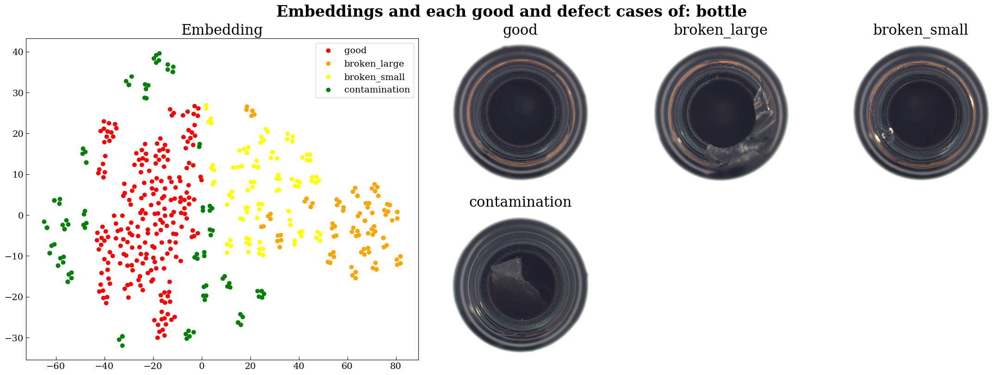

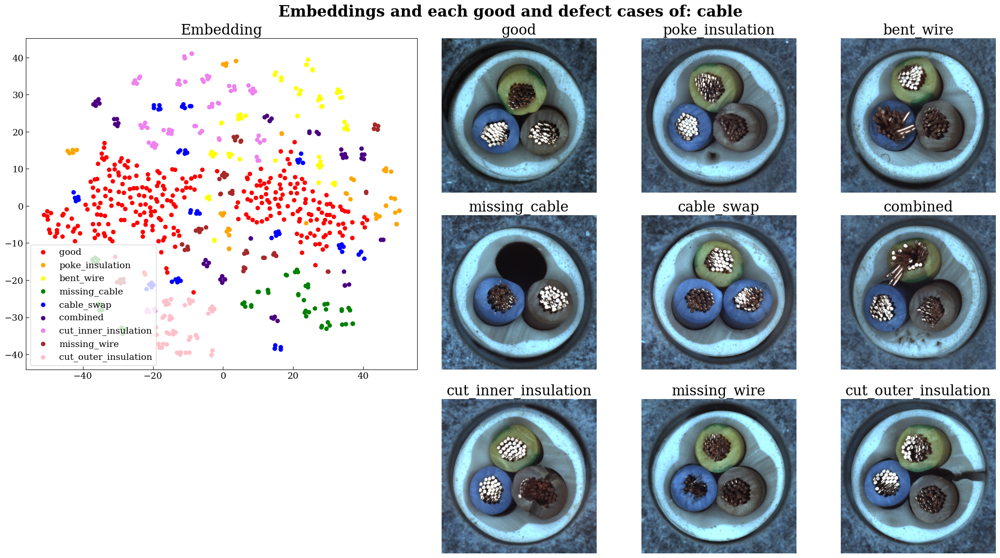

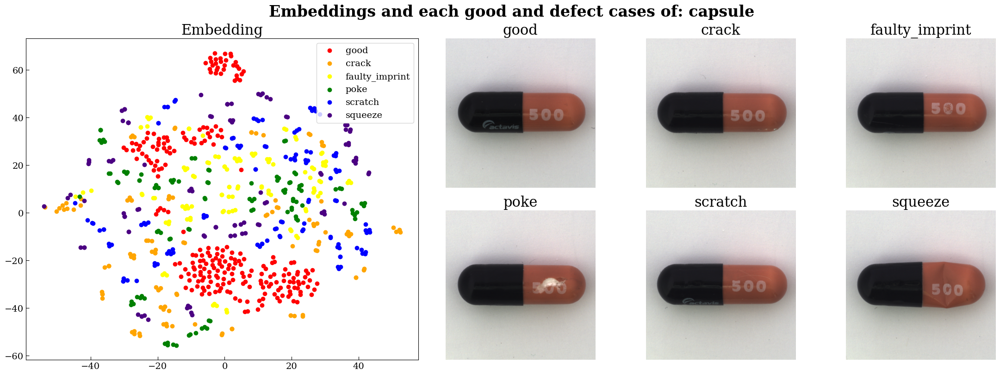

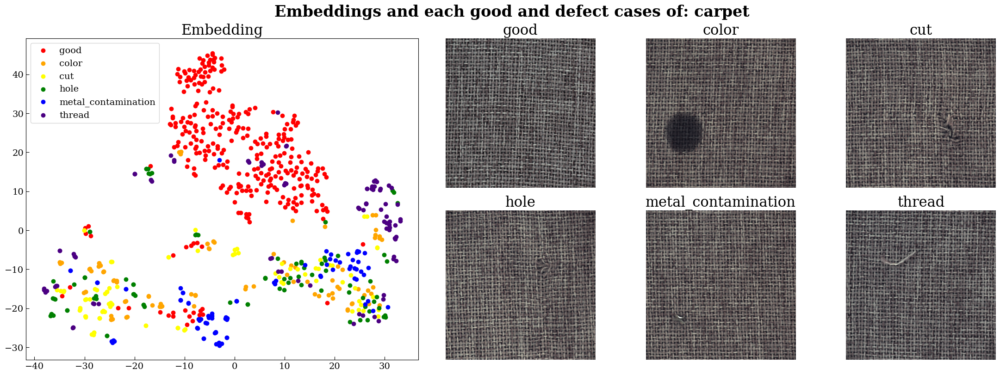

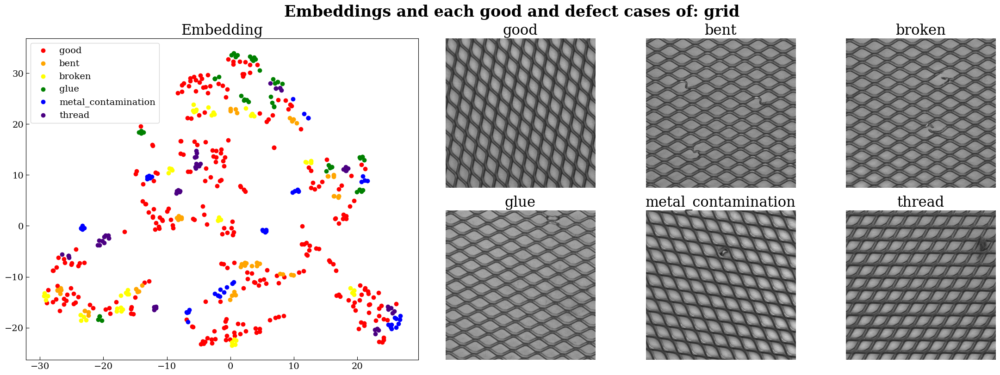

...

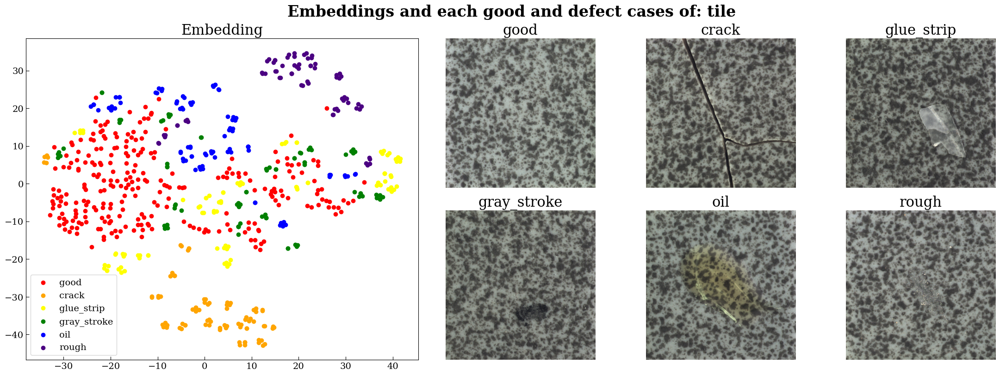

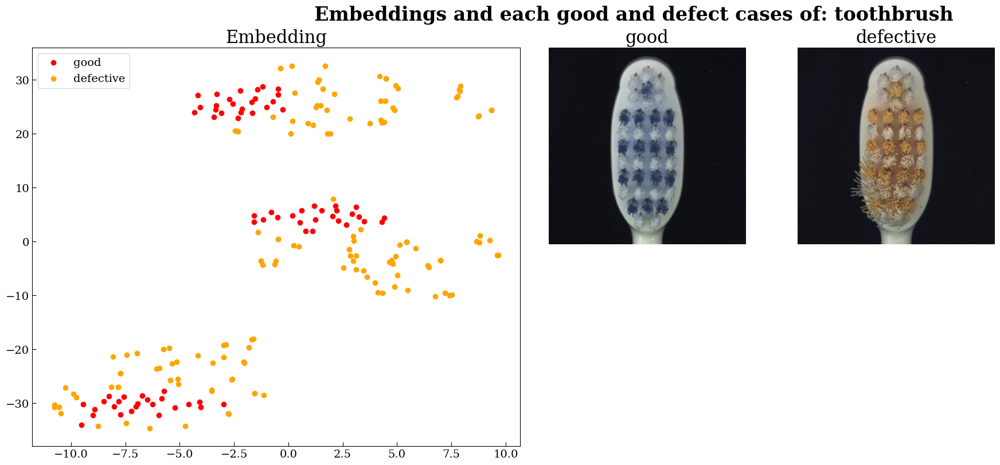

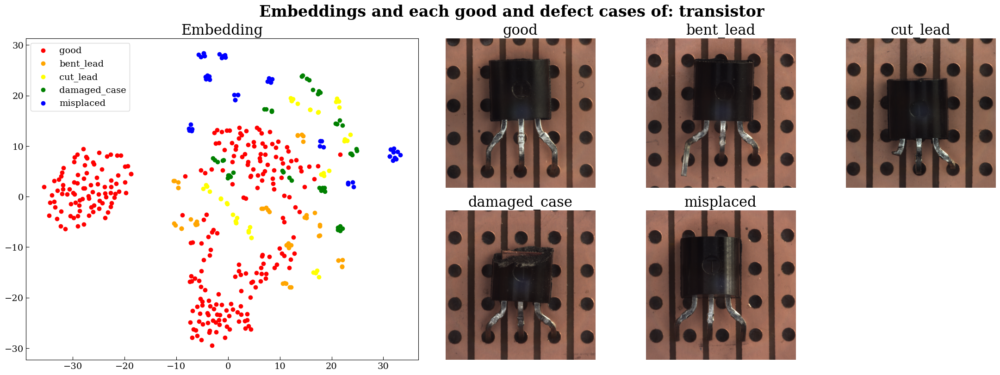

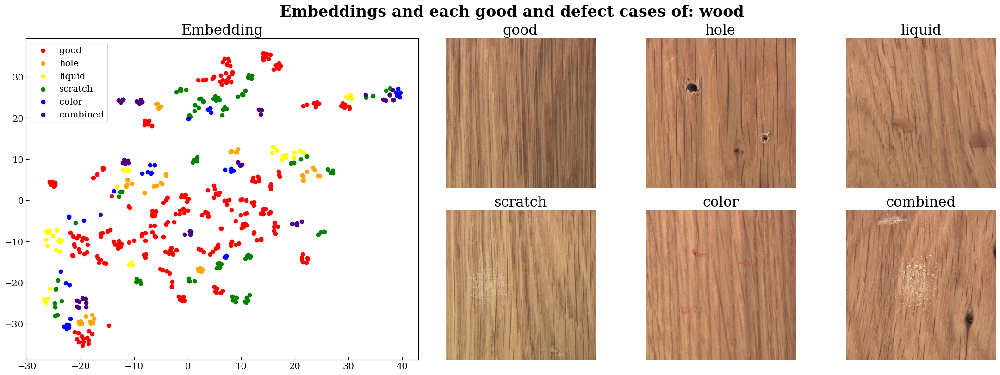

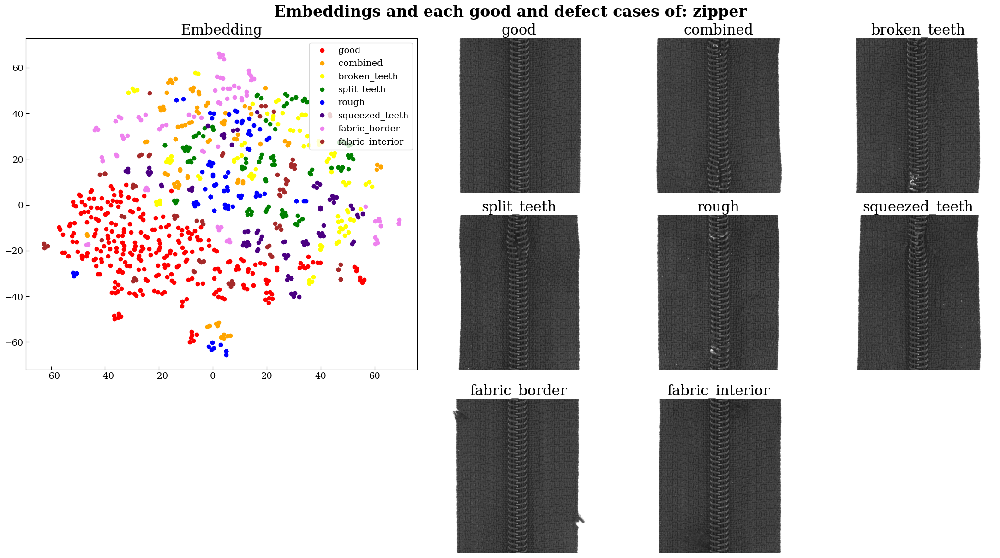

In [3]:
generate_each_product = True
if generate_each_product:
    # Resnet embeddings
    model = torchvision.models.resnet50(weights='ResNet50_Weights.DEFAULT')
    # model.fc = nn.Linear(2048, 2)
    modules=list(model.children())[:-1]
    model=nn.Sequential(*modules)
    for p in model.parameters():
        p.requires_grad = False
    device = 'cuda'
    model.to(device)
    
    for product in products:
        print(product)
        product_path = os.path.join(data_path, product)
        good_path = os.path.join(product_path, 'train')
        all_cases_path = [good_path] + [os.path.join(product_path, 'test', case)
                                        for case in os.listdir(os.path.join(product_path, 'test'))]
        case_name_list = [os.path.basename(case_path) for case_path in all_cases_path]
    
        # Calculate embeddings
        # Generate class id dict for visualization
        embedder = TSNE(2)
        label_case_dict = dict(zip(list(range(len(all_cases_path))), case_name_list))
        label_case_dict[0] = 'good'
        print(label_case_dict)
    
        # Load data
        cases_dict = {}
        for case_path in all_cases_path:
            case_name = os.path.basename(case_path) if os.path.basename(case_path) != 'train' else 'good'
            case_code = [key for key, value in label_case_dict.items() if value == case_name][0]
            for image_path in os.listdir(case_path):
                cases_dict[os.path.join(case_path, image_path)] = case_code
    
        #print(*list(cases_dict.items()), sep='\n')
        transform = transforms.Compose([transforms.ToTensor(),
                                        transforms.Resize((1024,1024), antialias=True)
                                        ])
        dataset = EmbeddingDataset(cases_dict, transform)
        dataloader = DataLoader(dataset, batch_size=12, shuffle=True)
    
        all_labels = []
        all_embeddings = []
        torch.cuda.empty_cache()
        model.eval()
        for data,labels in tqdm(dataloader):
            new_labels = labels.numpy().tolist()
            all_labels += new_labels
            data = data.to(device)
            embeddings = model(data)
            all_embeddings.append(np.reshape(embeddings.detach().cpu().numpy(),(len(new_labels),-1)))
        all_embeddings = np.vstack(all_embeddings)
    
        embeddings = embedder.fit_transform(all_embeddings)
        all_labels_name = [label_case_dict[label] for label in all_labels]
        colors = ['red', 'orange', 'yellow', 'green', 'blue', 'indigo', 'violet', 'brown', 'pink', 'navy']
        
        # Draw each image from each case and the overall embedding shape
        n_plots = len(case_name_list)
        n_col = 5
        n_row = (int(n_plots / (n_col - 2)) + (n_plots % (n_col - 2) > 0)) if (int(n_plots / (n_col - 2)) + (n_plots % (n_col - 2) > 0)) > 2 else 2
        
        #print(n_row, n_col)
        fig = plt.figure(layout="constrained", figsize=(16+6, n_row*4))
        
        gs = GridSpec(n_row, 5, figure=fig)
        ax = fig.add_subplot(gs[:2, :2])
        
        for label in label_case_dict.values():
            i = np.where(np.array(all_labels_name) == label)[0]
            embeddings_in_group = embeddings[i,:]
            ax.scatter(embeddings_in_group[:, 0], embeddings_in_group[:, 1], 
                       c=colors[list(label_case_dict.values()).index(label)], 
                       label=label)
        #scatter = ax.scatter(embeddings[:, 0], embeddings[:, 1], c=all_labels, cmap=color_map)
        ax.set_title('Embedding', fontsize=22)
        ax.legend()
        
        for i in range(n_plots):
            # Load first image from case:
            image = cv2.imread(os.path.join(all_cases_path[i], os.listdir(all_cases_path[i])[0]), cv2.IMREAD_COLOR)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            case_name = case_name_list[i] if case_name_list[i] != 'train' else 'good'
        
            # Draw images on remaining grid square
            # print(i // (n_col-2), 2 + i % (n_col-2))
            ax = fig.add_subplot(gs[i // (n_col-2), 2 + i % (n_col-2)])
            ax.imshow(image)
            ax.set_title(case_name, fontsize=22)
            ax.axis('off')
        fig.suptitle('Embeddings and each good and defect cases of: ' + product, fontsize=24, fontweight='bold')
        fig.savefig(root_path + '/Figure/data_analysis/' + product + '.png')

In [4]:
generate_each_embeddings = False
if generate_each_embeddings:
    # Resnet embeddings
    model = torchvision.models.resnet50(weights='ResNet50_Weights.DEFAULT')
    # model.fc = nn.Linear(2048, 2)
    modules=list(model.children())[:-1]
    model=nn.Sequential(*modules)
    for p in model.parameters():
        p.requires_grad = False
    device = 'cuda'
    model.to(device)
    
    for product in products[:]:
        print(product)
        product_path = os.path.join(data_path, product)
        good_path = os.path.join(product_path, 'train')
        all_cases_path = [good_path] + [os.path.join(product_path, 'test', case)
                                        for case in os.listdir(os.path.join(product_path, 'test'))]
        case_name_list = [os.path.basename(case_path) for case_path in all_cases_path]
    
        # Calculate embeddings
        # Generate class id dict for visualization
        label_case_dict = dict(zip(list(range(len(all_cases_path))), case_name_list))
        label_case_dict[0] = 'good'
        print(label_case_dict)
    
        # Load data
        cases_dict = {}
        for case_path in all_cases_path:
            case_name = os.path.basename(case_path) if os.path.basename(case_path) != 'train' else 'good'
            case_code = [key for key, value in label_case_dict.items() if value == case_name][0]
            for image_path in os.listdir(case_path):
                cases_dict[os.path.join(case_path, image_path)] = case_code
    
        #print(*list(cases_dict.items()), sep='\n')
        transform = transforms.Compose([transforms.ToTensor(),
                                        transforms.Resize((1024,1024), antialias=True)
                                        ])
        dataset = EmbeddingDataset(cases_dict, transform)
        dataloader = DataLoader(dataset, batch_size=12, shuffle=True)
    
        all_labels = []
        all_embeddings = []
        torch.cuda.empty_cache()
        model.eval()
        for data,labels in tqdm(dataloader):
            new_labels = labels.numpy().tolist()
            all_labels += new_labels
            data = data.to(device)
            embeddings = model(data)
            all_embeddings.append(np.reshape(embeddings.detach().cpu().numpy(),(len(new_labels),-1)))
        all_embeddings = np.vstack(all_embeddings)

        embedder_2D = TSNE(2)
        embeddings_2D = embedder_2D.fit_transform(all_embeddings)
        embedder_1D = TSNE(2)
        embeddings_1D = embedder_1D.fit_transform(all_embeddings)
        all_labels_name = [label_case_dict[label] for label in all_labels]

        fig, ax = plt.subplots(1, 2, figsize=(11, 5))
        scatter = ax[0].scatter(embeddings_2D[:, 0], embeddings_2D[:, 1], c=all_labels)
        ax[0].title.set_text('Embedding')
        ax[0].legend(handles=scatter.legend_elements()[0], labels=np.unique(all_labels_name).tolist())
        
        for case_id in label_case_dict.keys():
            case_sample = embeddings_1D[np.where(np.array(all_labels) == case_id)]
            ax[1].hist(case_sample, alpha=0.75, density=True, label=label_case_dict[case_id])
        ax[1].legend()

        fig.savefig(root_path + '/Figure/data_analysis/' + product + '_embeddings.png')

### Visualize each backbone's performance and each inference scheme on each product

In [7]:
visualize_performance = False
if visualize_performance:
    backbone_list = ['resnet18', 'resnet34', 'resnet50', 'wide_resnet', 'vgg']
    scheme_list = ['avg_distance', 'cosine_distance',  'golden_image', 'one_good_image']
    backbone_score_path_dict = {}
    for product in products:
        print('----------------------------- ' + product + ' -----------------------------')
        n_backbone = len([os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv') 
                          for backbone in backbone_list
                          if os.path.exists(os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv'))])
        print('Number of available backbone:', n_backbone)
        # Count number of backbone available for the product and obtain all scoring sheet calculated from the backbone:
        scheme_backbone_score_path_dict = {}
        for scheme in scheme_list:
            score_path_list = []
            for backbone in backbone_list:
                score_path = os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_' + scheme + '.csv')
                if os.path.exists(score_path):
                    score_path_list.append((backbone, score_path))
            scheme_backbone_score_path_dict[scheme] = score_path_list
        # Load in the backbone-scoring_path to start drawing the figures
        fig = plt.figure(layout='constrained', figsize=(n_backbone*3, 5*3+3))
        subfigs = fig.subfigures(len(scheme_list), 1, hspace=0.07)
        for scheme, score_path_list in list(scheme_backbone_score_path_dict.items()):
            #print('----------------------------- ' + scheme + ' -----------------------------')
            #print(*score_path_list, sep='\n')
            scheme_id = scheme_list.index(scheme)
            ax = subfigs[scheme_id].subplots(1, n_backbone)
            for i in range(len(score_path_list)):
                backbone_name, score_sheet_path = score_path_list[i]
                plot_name = 'Inference scheme: '
                if scheme == 'avg_distance':
                    plot_name = 'closest embedding scheme'
                elif scheme == 'cosine_distance':
                    plot_name = 'closest embedding by consine similarity scheme' 
                elif scheme == 'mahalanobis_distance':
                    plot_name = 'closest embedding by Mahalanobis distance scheme' 
                elif scheme == 'golden_image':
                    plot_name = 'golden image scheme' 
                else:
                    plot_name = 'one good image scheme'
    
                plot_name += ', for ' + product.upper()
                    
                # Load the score sheet:
                result = np.loadtxt(score_sheet_path, delimiter=",")
                
                # distinguish the scores
                same_class = result[:,2]
                if len(np.unique(same_class)) != 2:
                    print(np.unique(same_class))
                similarity_scores = result[:,3]
                
                dissimillar_idx = np.where(same_class == 0.)
                dissimillar_score = similarity_scores[dissimillar_idx]
                simillar_idx = np.where(same_class == 1.)
                simillar_score = similarity_scores[simillar_idx]
                
                #ax[i].violinplot([simillar_score, dissimillar_score], vert=True, 
                                        #showmeans=True, showextrema=True)
                ax[i].boxplot([simillar_score, dissimillar_score], vert=True, 
                                        notch=True)
                labels=['good', 'defects']
                valid_range = np.arange(0, np.max(dissimillar_score)+0.5, 0.5) if np.max(dissimillar_score) < 10 else np.arange(0, np.max(dissimillar_score)+0.5, 2) 
                ax[i].set_xticks(np.arange(1, len(labels) + 1), labels=labels)
                ax[i].set_yticks(valid_range)
                ax[i].set_ylim([-0.5, np.max(dissimillar_score)+0.5])
                backbone_name = 'vgg11' if backbone_name == 'vgg' else backbone_name
                ax[i].set_title(backbone_name)
            subfigs[scheme_id].suptitle(plot_name, fontsize=12)
        # Save figure
        fig.suptitle('Simillarity score distribution of each backbone and inference scheme for ' + product.upper(), fontsize=16)
        figure_name = product + '_similarity_score_distribution_box_plot.png'
        figure_path = os.path.join(root_path, 
                'Figure/similarity_score_box_plot/' + figure_name)
        fig.savefig(figure_path)
        #print(*score_path_list, sep='\n')

----------------------------- bottle -----------------------------
Number of available backbone: 4
----------------------------- cable -----------------------------
Number of available backbone: 3
----------------------------- capsule -----------------------------
Number of available backbone: 2
----------------------------- carpet -----------------------------
Number of available backbone: 2
----------------------------- grid -----------------------------
Number of available backbone: 2
----------------------------- hazelnut -----------------------------
Number of available backbone: 2
----------------------------- leather -----------------------------
Number of available backbone: 2
----------------------------- metal_nut -----------------------------
Number of available backbone: 3
----------------------------- pill -----------------------------
Number of available backbone: 2
----------------------------- screw -----------------------------
Number of available backbone: 2
---------

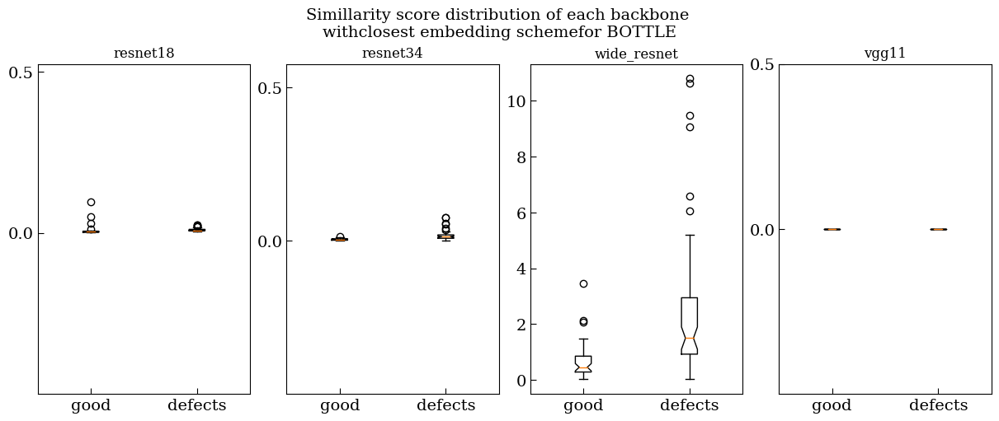

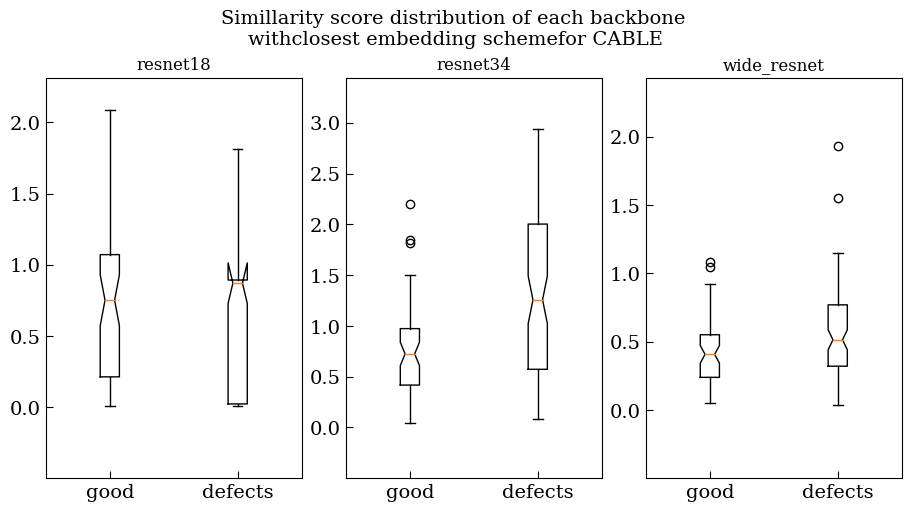

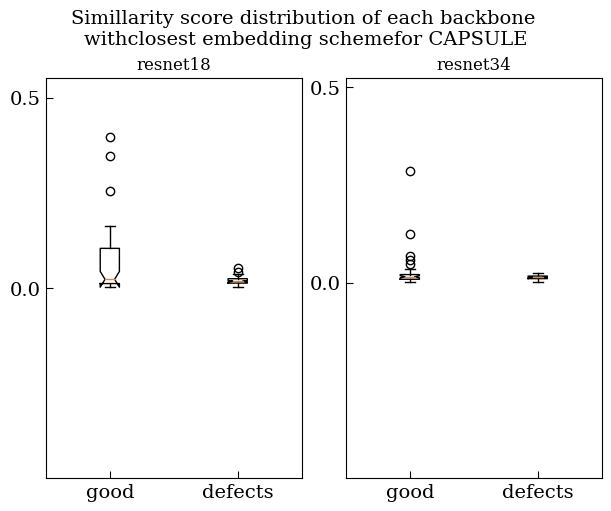

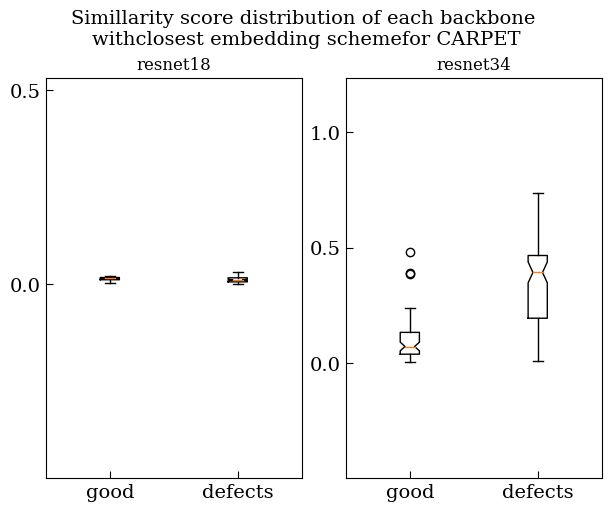

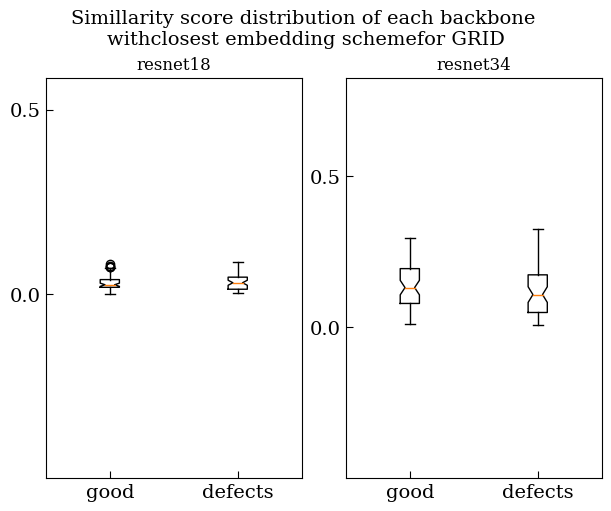

...

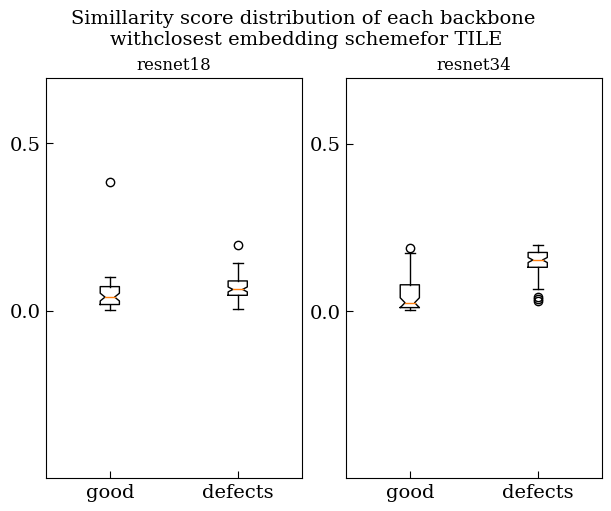

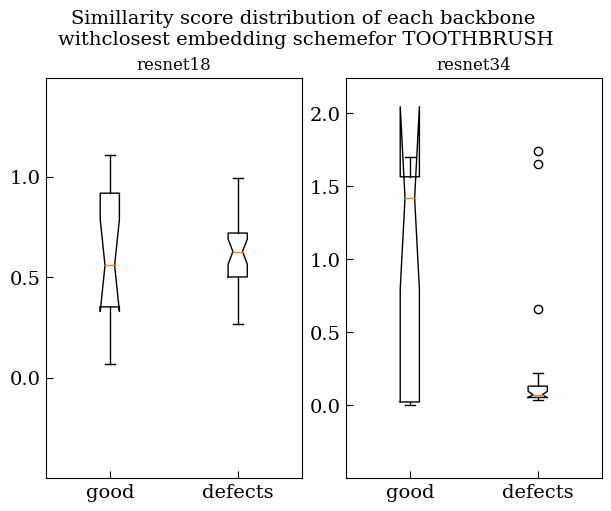

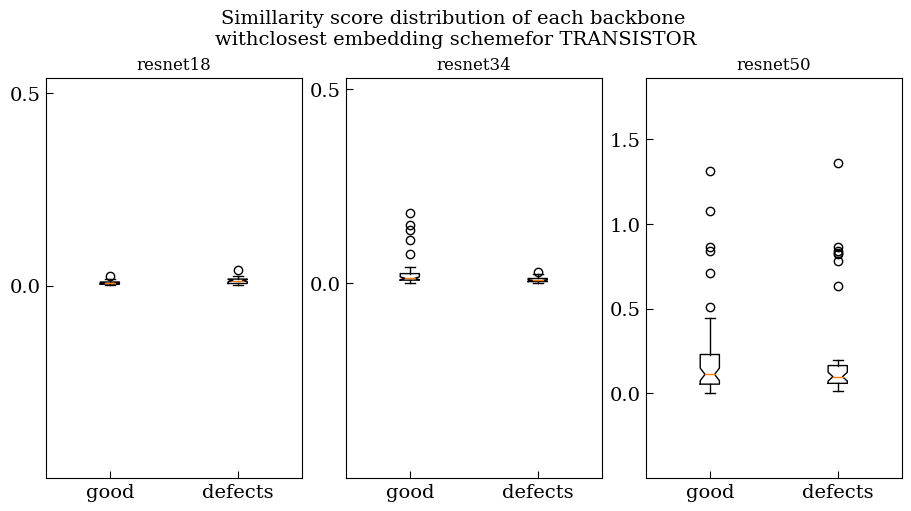

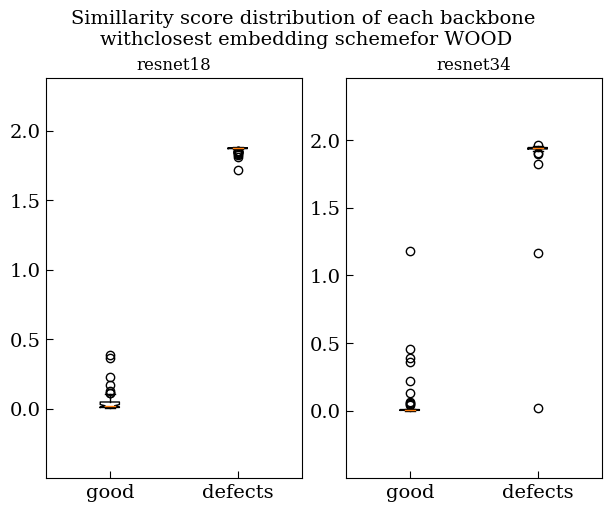

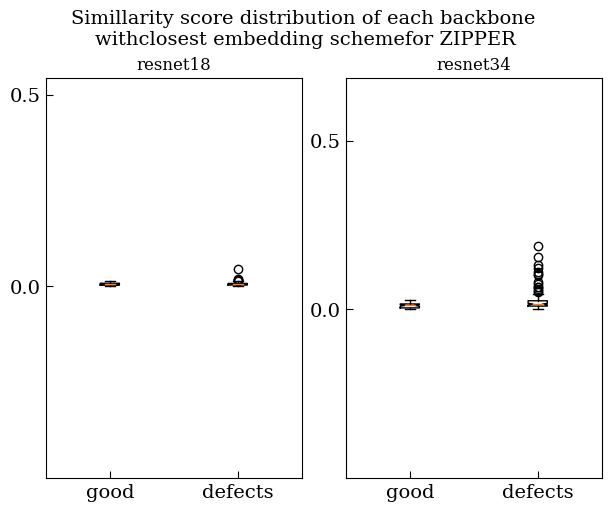

In [8]:
visualize_performance_one_scheme = True
if visualize_performance_one_scheme:
    backbone_list = ['resnet18', 'resnet34', 'resnet50', 'wide_resnet', 'vgg']
    scheme = 'avg_distance'

    if scheme == 'avg_distance':
        plot_name = 'closest embedding scheme'
    elif scheme == 'cosine_distance':
        plot_name = 'closest embedding by consine similarity scheme' 
    elif scheme == 'mahalanobis_distance':
        plot_name = 'closest embedding by Mahalanobis distance scheme' 
    elif scheme == 'golden_image':
        plot_name = 'golden image scheme' 
    else:
        plot_name = 'one good image scheme'

    backbone_score_path_dict = {}
    for product in products:
        print('----------------------------- ' + product + ' -----------------------------')
        # Count the number of different backbone by just taking one inference scheme and count the number of csv files
        n_backbone = len([os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv') 
                          for backbone in backbone_list
                          if os.path.exists(os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv'))])
        print('Number of available backbone:', n_backbone)
        # Obtain all backbone name and its corresponding score path
        score_path_list = []
        for backbone in backbone_list:
            score_path = os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_' + scheme + '.csv')
            # Append the backbone-score path if the score path corresponding to that backbone exists
            if os.path.exists(score_path):
                score_path_list.append((backbone, score_path))

        # Load in the backbone-scoring_path to start drawing the figures
        fig, ax = plt.subplots(1, n_backbone,layout='constrained', figsize=(n_backbone*3, 5))
        for i in range(len(score_path_list)):
            backbone_name, score_sheet_path = score_path_list[i]

            # Load the score sheet:
            result = np.loadtxt(score_sheet_path, delimiter=",")

                # distinguish the scores
            same_class = result[:,2]
            if len(np.unique(same_class)) != 2:
                print(np.unique(same_class))
            similarity_scores = result[:,3]
            
            dissimillar_idx = np.where(same_class == 0.)
            dissimillar_score = similarity_scores[dissimillar_idx]
            simillar_idx = np.where(same_class == 1.)
            simillar_score = similarity_scores[simillar_idx]
            
            #ax[i].violinplot([simillar_score, dissimillar_score], vert=True, 
                                    #showmeans=True, showextrema=True)
            ax[i].boxplot([simillar_score, dissimillar_score], vert=True, 
                                    notch=True)
            labels=['good', 'defects']
            valid_range = np.arange(0, 
                    np.max(dissimillar_score)+0.5, 0.5) if np.max(dissimillar_score) < 10 else np.arange(0, np.max(dissimillar_score)+0.5, 2) 
            ax[i].set_xticks(np.arange(1, len(labels) + 1), labels=labels)
            ax[i].set_yticks(valid_range)
            ax[i].set_ylim([-0.5, np.max(dissimillar_score)+0.5])
            backbone_name = 'vgg11' if backbone_name == 'vgg' else backbone_name
            ax[i].set_title(backbone_name, fontsize=12)
        # Save figure
        fig.suptitle('Simillarity score distribution of each backbone \nwith' + plot_name + 'for ' + product.upper(), fontsize=14)
        figure_name = product + '_similarity_score_distribution_box_plot_' + scheme + '.png'
        figure_path = os.path.join(root_path, 
                'Figure/similarity_score_box_plot/' + figure_name)
        fig.savefig(figure_path)
        

----------------------------- bottle -----------------------------
Number of available backbone: 4
----------------------------- cable -----------------------------
Number of available backbone: 3
----------------------------- capsule -----------------------------
Number of available backbone: 2
----------------------------- carpet -----------------------------
Number of available backbone: 2
----------------------------- grid -----------------------------
Number of available backbone: 2
----------------------------- hazelnut -----------------------------
Number of available backbone: 2
----------------------------- leather -----------------------------
Number of available backbone: 2
----------------------------- metal_nut -----------------------------
Number of available backbone: 3
----------------------------- pill -----------------------------
Number of available backbone: 2
----------------------------- screw -----------------------------
Number of available backbone: 2
---------

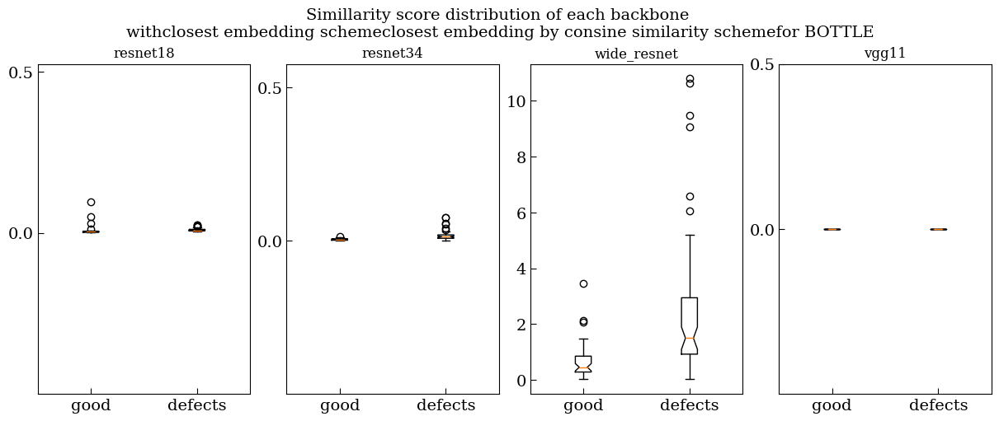

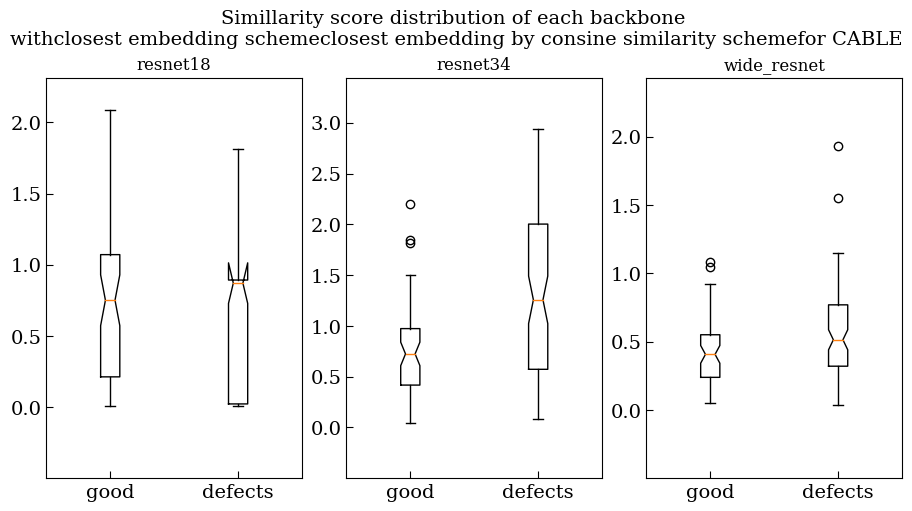

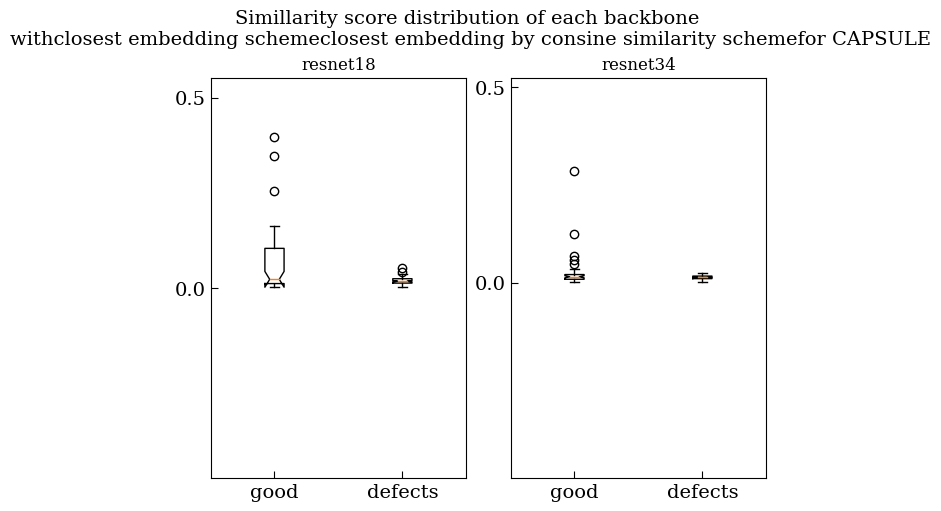

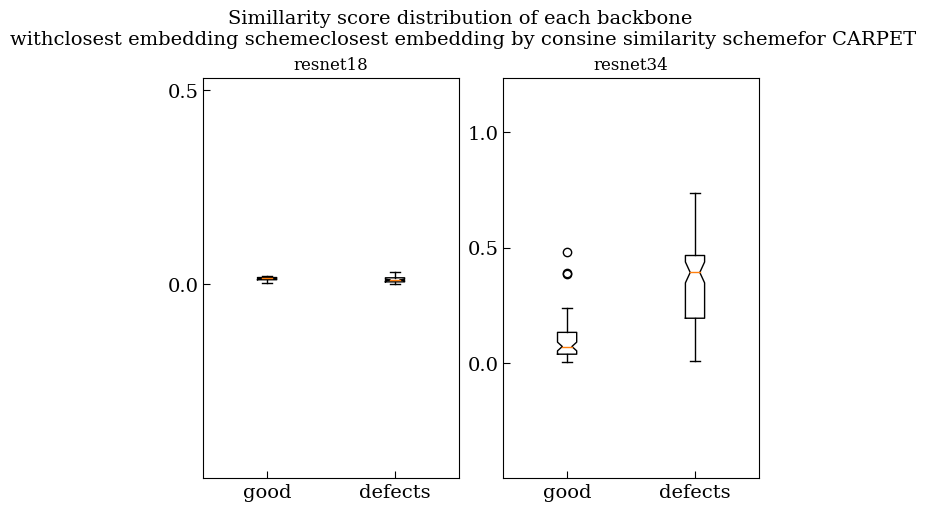

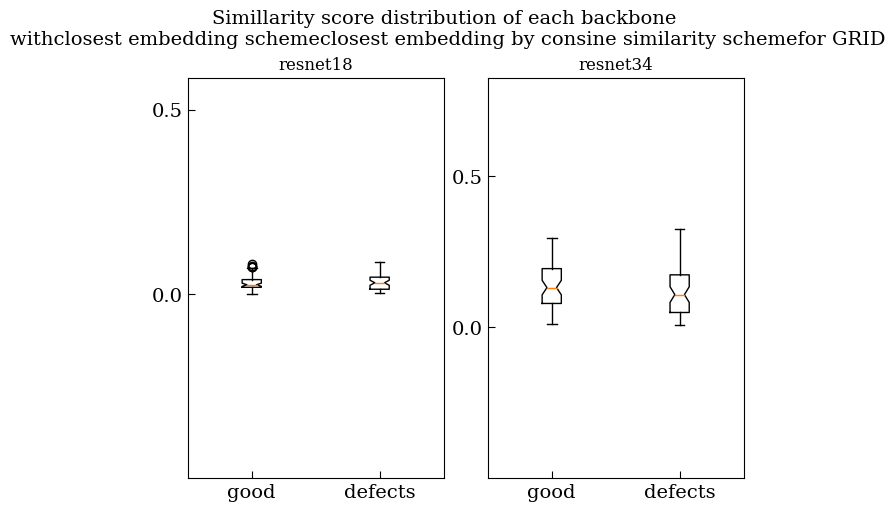

...

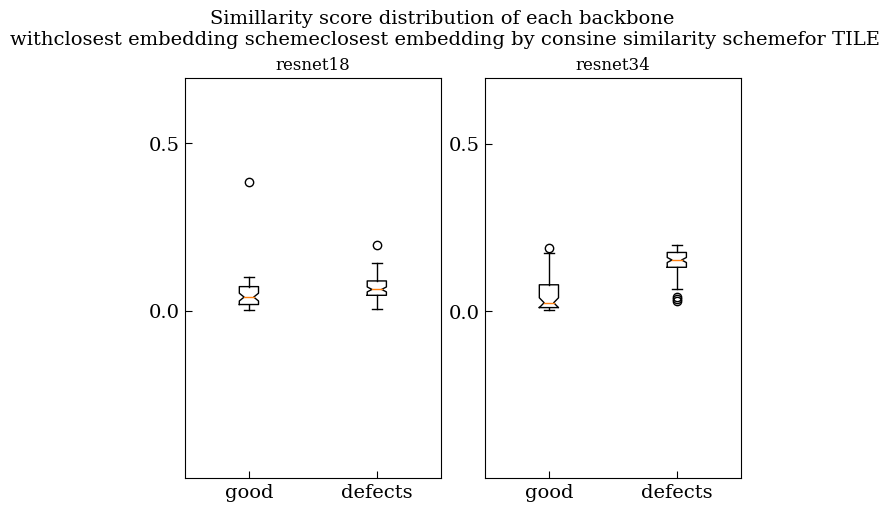

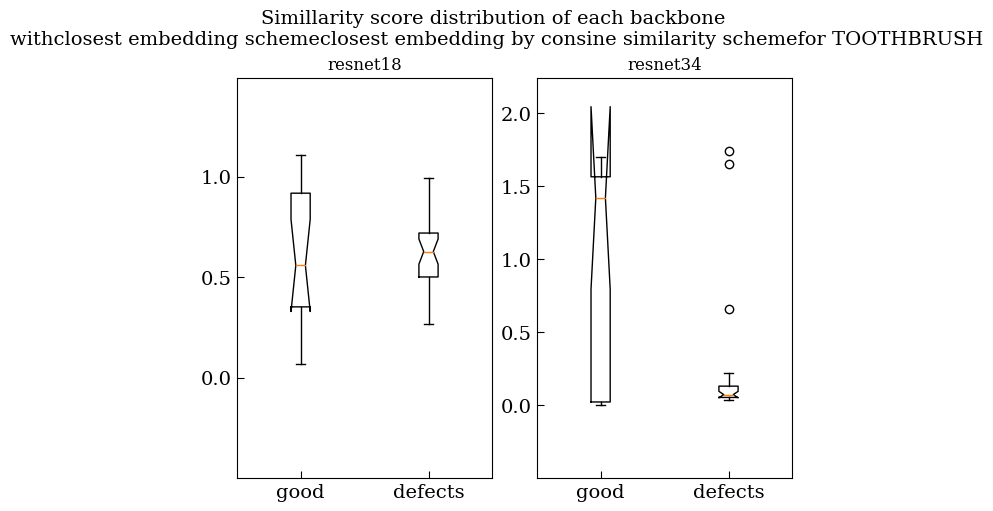

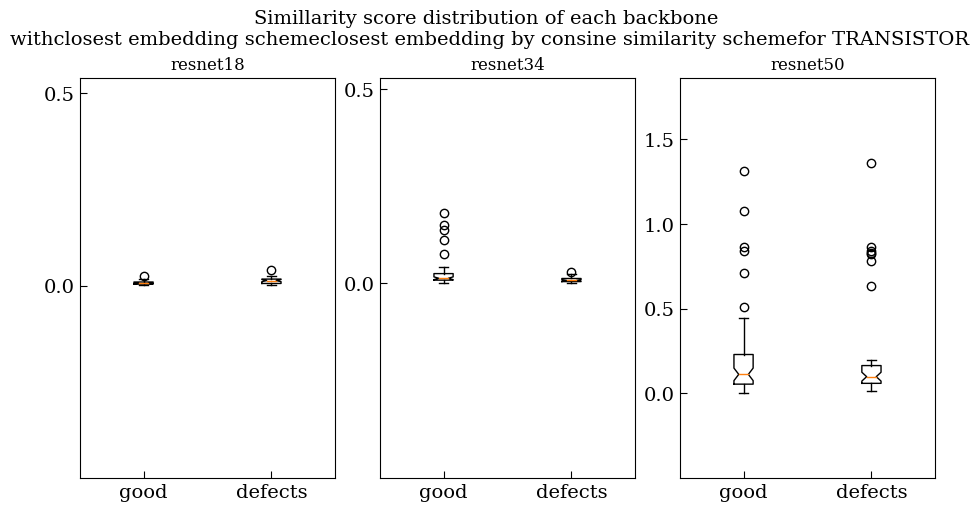

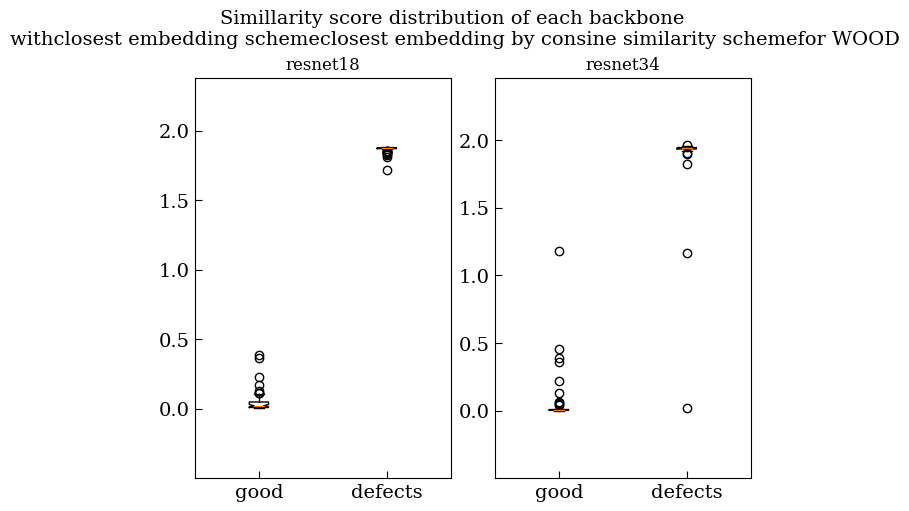

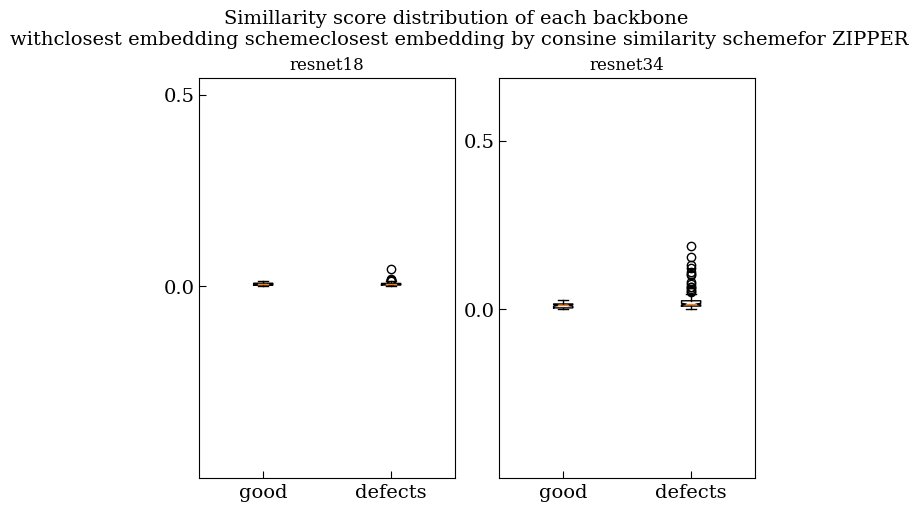

In [9]:
visualize_performance_one_scheme = True
if visualize_performance_one_scheme:
    backbone_list = ['resnet18', 'resnet34', 'resnet50', 'wide_resnet', 'vgg']
    scheme = 'cosine_distance'

    if scheme == 'avg_distance':
        plot_name += 'closest embedding scheme'
    elif scheme == 'cosine_distance':
        plot_name += 'closest embedding by consine similarity scheme' 
    elif scheme == 'mahalanobis_distance':
        plot_name += 'closest embedding by Mahalanobis distance scheme' 
    elif scheme == 'golden_image':
        plot_name += 'golden image scheme' 
    else:
        plot_name += 'one good image scheme'

    backbone_score_path_dict = {}
    for product in products:
        print('----------------------------- ' + product + ' -----------------------------')
        # Count the number of different backbone by just taking one inference scheme and count the number of csv files
        n_backbone = len([os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv') 
                          for backbone in backbone_list
                          if os.path.exists(os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_avg_distance.csv'))])
        print('Number of available backbone:', n_backbone)
        # Obtain all backbone name and its corresponding score path
        score_path_list = []
        for backbone in backbone_list:
            score_path = os.path.join(root_path, 'result/similarity_scores', product + '_siamese_' + backbone + '_' + scheme + '.csv')
            # Append the backbone-score path if the score path corresponding to that backbone exists
            if os.path.exists(score_path):
                score_path_list.append((backbone, score_path))

        # Load in the backbone-scoring_path to start drawing the figures
        fig, ax = plt.subplots(1, n_backbone,layout='constrained', figsize=(n_backbone*3, 5))
        for i in range(len(score_path_list)):
            backbone_name, score_sheet_path = score_path_list[i]

            # Load the score sheet:
            result = np.loadtxt(score_sheet_path, delimiter=",")

                # distinguish the scores
            same_class = result[:,2]
            if len(np.unique(same_class)) != 2:
                print(np.unique(same_class))
            similarity_scores = result[:,3]
            
            dissimillar_idx = np.where(same_class == 0.)
            dissimillar_score = similarity_scores[dissimillar_idx]
            simillar_idx = np.where(same_class == 1.)
            simillar_score = similarity_scores[simillar_idx]
            
            #ax[i].violinplot([simillar_score, dissimillar_score], vert=True, 
                                    #showmeans=True, showextrema=True)
            ax[i].boxplot([simillar_score, dissimillar_score], vert=True, 
                                    notch=True)
            labels=['good', 'defects']
            valid_range = np.arange(0, 
                    np.max(dissimillar_score)+0.5, 0.5) if np.max(dissimillar_score) < 10 else np.arange(0, np.max(dissimillar_score)+0.5, 2) 
            ax[i].set_xticks(np.arange(1, len(labels) + 1), labels=labels)
            ax[i].set_yticks(valid_range)
            ax[i].set_ylim([-0.5, np.max(dissimillar_score)+0.5])
            backbone_name = 'vgg11' if backbone_name == 'vgg' else backbone_name
            ax[i].set_title(backbone_name, fontsize=12)
        # Save figure
        fig.suptitle('Simillarity score distribution of each backbone \nwith' + plot_name + 'for ' + product.upper(), fontsize=14)
        figure_name = product + '_similarity_score_distribution_box_plot_' + scheme + '.png'
        figure_path = os.path.join(root_path, 
                'Figure/similarity_score_box_plot/' + figure_name)
        fig.savefig(figure_path)
        